<a href="https://colab.research.google.com/github/psc-g/ganterpretation/blob/master/GANterpretations_(playground_for_inflection_threshold).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GANterpretations

This notebook is meant to allow you to explore the setting of the parameters for generating GAN videos from an audio file.

See details [here](https://github.com/psc-g/ganterpretation).

**Disclaimer**

This notebook is based on the [BigGAN demo](https://colab.research.google.com/github/tensorflow/hub/blob/master/examples/colab/biggan_generation_with_tf_hub.ipynb).

In [1]:
# @title Imports
import cStringIO
import IPython.display
import numpy as np
import PIL.Image
from scipy.stats import truncnorm
import tensorflow as tf
import tensorflow_hub as hub
from scipy.io import wavfile
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio
from IPython.display import HTML, display
import cv2
import os

## Process your audio file
On the left bar (if it isn't there click on `View -> Table of contents` in the menu above), click on the `Files` tab.

Click on `UPLOAD` and upload a .wav file (verify the directory where it was uploaded, typically `/content`).

In [2]:
# @title Upload the audio file
wav_path = '/scooby_doo.wav'  # @param {type: 'string'}
base_dir = '/tmp/stft'  # @param {type: 'string'}
framerate, sounddata = wavfile.read(wav_path)
sounddata = sounddata.T
time = np.arange(0, sounddata.shape[1]) / framerate
total_time = sounddata.shape[1]/framerate
!mkdir -p $base_dir/images
print('Sample rate: {}Hz'.format(framerate))
print('Total time: {}s'.format(total_time))

Sample rate: 44100Hz
Total time: 126s


Iterate on the cell below, playing around with the `inflection_threshold`. Once you have something you're happy with, run the code in the [github repo](https://github.com/psc-g/ganterpretation) with this setting for producing the video.

This specifies how many inflection points will be produced, which can be useful if you want to select categories manually.

Number of inflection points: 25


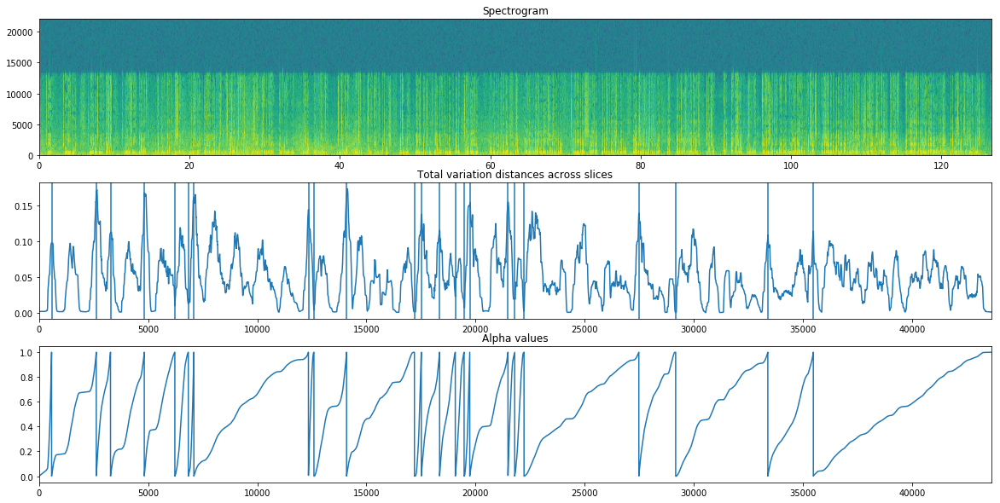

In [7]:
# @title Get the audio spectrogram and inflection points.
def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / float(N)


def add_inflection_points(ax, arr, threshold, absolute_threshold=8e-2,
                          type='both', rolling_length=200):
  inflection_points = [0]
  i = 0
  while i < len(arr) - rolling_length - 1:
    prev_mean = np.mean(arr[i:i+rolling_length])
    curr_pos = i + rolling_length + 1
    next_mean = np.mean(arr[curr_pos+1:curr_pos+rolling_length+1])
    if (np.sign(arr[curr_pos] - prev_mean) == np.sign(arr[curr_pos] - next_mean) and
        np.sign(arr[curr_pos] - arr[curr_pos-1]) == np.sign(arr[curr_pos] - arr[curr_pos+1]) and
        np.abs(arr[curr_pos] - prev_mean) > threshold and
        np.abs(arr[curr_pos] - next_mean) > threshold):
      if ((type == 'min' and (arr[curr_pos] > prev_mean or arr[curr_pos] > absolute_threshold)) or
          (type == 'max' and arr[curr_pos] < arr[curr_pos-1])):
        i += rolling_length
        continue
      inflection_points.append(curr_pos)
      ax.axvline(curr_pos)
      i += rolling_length
    else:
      i += 1
  inflection_points.append(len(arr) - 1)
  return np.array(inflection_points)


def get_alphas(arr):
  cumsum = np.cumsum(arr)
  total_sum = np.sum(arr)
  return cumsum / total_sum

channel_to_use = 'Left'  # @param ['Left', 'Right']
inflection_threshold =   3e-2 # @param {type:'number'}
channel = 0 if channel_to_use == 'Left' else 1
fig = plt.figure(figsize=(20, 10))
ax = fig.add_subplot(311)
spectrum, frequencies, t, im = ax.specgram(sounddata[channel],
                                           Fs=framerate)
ax.set_title('Spectrogram')
tv_diffs = [np.mean(np.abs(spectrum[:, i] - spectrum[:, i + 1])) for i in range(spectrum.shape[1] - 1)]
tv_diffs /= max(tv_diffs)
running_mean_tv_diffs = running_mean(tv_diffs, 256)
running_mean_tv_diffs = np.append(np.array([running_mean_tv_diffs[0]] * 256),
                                  running_mean_tv_diffs)
ax2 = fig.add_subplot(312)
ax2.plot(running_mean_tv_diffs)
ax2.set_xlim(0, spectrum.shape[1])
ax2.set_title('Total variation distances across slices')
inflection_points = add_inflection_points(ax2, running_mean_tv_diffs,
                                          inflection_threshold,
                                          type='both')

alphas = np.array([])
next_inflection_idx = 1
i = 1
while i < len(running_mean_tv_diffs):
  next_i = inflection_points[next_inflection_idx]
  alphas = np.concatenate((alphas, get_alphas(running_mean_tv_diffs[i:next_i])))
  i = next_i
  next_inflection_idx += 1
  if next_inflection_idx >= len(inflection_points):
    break

alphas = np.concatenate((alphas, [1.0]))
ax3 = fig.add_subplot(313)
ax3.plot(alphas)
ax3.set_xlim(0, spectrum.shape[1])
ax3.set_title('Alpha values')
print('Number of inflection points: {}'.format(len(inflection_points)))
Audio(sounddata, rate=framerate)

In [ ]:
# @title (Optional) Compile spectrogram video, then download from bar on left

# The smaller you set this value, the choppier the video will be,
# but the faster this cell will run.
frameskips_for_video = 10  # @param {type: 'number'}
steps = min(framerate, sounddata.shape[1])
increments = framerate // frameskips_for_video
for i in range(0, sounddata.shape[1] - steps + 1, increments):
  _ = plt.specgram(sounddata[0][i:i + steps], Fs=framerate)
  plt.xticks([])
  plt.yticks([])
  plt.savefig('{}/images/{:06d}.png'.format(base_dir, i))

!rm -f /tmp/stft/video.mp4
fps = frameskips_for_video
files = [f for f in os.listdir(os.path.join(base_dir, 'images'))]
files.sort()
vid = None
for i in range(len(files)):
  filename = os.path.join(base_dir, 'images', files[i])
  img = cv2.imread(filename)
  if vid is None:
    height, width, _ = img.shape
    size = (width, height)
    vid = cv2.VideoWriter(os.path.join(base_dir, 'video.mp4'),
                          cv2.VideoWriter_fourcc(*'XVID'), fps,
                          (width, height))
  vid.write(img)
vid.release()